# My Own Transformer - POP909 MIDI Visualization and Listening

This notebook downloads POP909, shows what it contains, visualizes the first MIDI track, and lets you listen to it.


In [1]:
# Download POP909 (ZIP) and extract it
from pathlib import Path
import urllib.request
import zipfile

project_dir = Path.cwd()
if (project_dir / 'NeuralNetworks' / 'My Own Transformer').exists():
    project_dir = project_dir / 'NeuralNetworks' / 'My Own Transformer'
elif (project_dir / 'My Own Transformer').exists():
    project_dir = project_dir / 'My Own Transformer'

datasets_dir = project_dir / 'datasets'
datasets_dir.mkdir(parents=True, exist_ok=True)

zip_path = datasets_dir / 'POP909.zip'
extract_dir = datasets_dir / 'POP909-Dataset-master'

if not extract_dir.exists():
    if not zip_path.exists():
        url = 'https://github.com/music-x-lab/POP909-Dataset/archive/refs/heads/master.zip'
        print('Downloading POP909...')
        urllib.request.urlretrieve(url, zip_path)
        print(f'Downloaded: {zip_path}')

    print('Extracting POP909...')
    with zipfile.ZipFile(zip_path, 'r') as zf:
        zf.extractall(datasets_dir)
    print(f'Extracted to: {extract_dir}')
else:
    print(f'POP909 already available at: {extract_dir}')


POP909 already available at: /Users/alfonsomestre/Documents/Projects/Data Science/Machine Learning Portfolio/MachineLearning/NeuralNetworks/My Own Transformer/datasets/POP909-Dataset-master


In [2]:
# Install required libraries
import sys
import subprocess

subprocess.check_call([
    sys.executable, '-m', 'pip', 'install', '-q',
    'pretty_midi', 'matplotlib', 'numpy'
])


0

In [3]:
from pathlib import Path
import numpy as np
import pretty_midi
import matplotlib.pyplot as plt
from IPython.display import Audio, display


## Dataset structure (POP909)

POP909 contains 909 pop-song arrangements. Each song is in a numbered folder (e.g., `001`, `002`, ...).
Typical contents per song include:

- `XXX.mid`: the MIDI file (arrangement with melody and accompaniment tracks)
- `beat_midi.txt`: beat times extracted from MIDI
- `chord_midi.txt`: chord labels extracted from MIDI
- `key_audio.txt`: key changes extracted from audio
- `chord_audio.txt`, `beat_audio.txt`: annotations extracted from audio

The dataset also provides processing scripts to convert to event-based representations.


In [4]:
# Show what the dataset contains
pop_root = extract_dir / 'POP909'
if not pop_root.exists():
    raise FileNotFoundError(f'POP909 folder not found at: {pop_root}')

song_dirs = sorted([d for d in pop_root.iterdir() if d.is_dir()])
print(f'Total songs: {len(song_dirs)}')
print('First 10 song folders:', [d.name for d in song_dirs[:10]])


Total songs: 909
First 10 song folders: ['001', '002', '003', '004', '005', '006', '007', '008', '009', '010']


In [5]:
# Inspect the first song folder contents
first_song_dir = song_dirs[0]
print('First song folder:', first_song_dir)
print('Files:')
for item in sorted(first_song_dir.iterdir()):
    print('  ', item.name)


First song folder: /Users/alfonsomestre/Documents/Projects/Data Science/Machine Learning Portfolio/MachineLearning/NeuralNetworks/My Own Transformer/datasets/POP909-Dataset-master/POP909/001
Files:
   001.mid
   beat_audio.txt
   beat_midi.txt
   chord_audio.txt
   chord_midi.txt
   key_audio.txt
   versions


In [6]:
# Show a preview of annotation files (if present)
def preview_file(path, n_lines=5):
    if not path.exists():
        print(f'{path.name}: not found')
        return
    print(f'\n{path.name} (first {n_lines} lines):')
    with path.open('r', encoding='utf-8') as f:
        for _ in range(n_lines):
            line = f.readline()
            if not line:
                break
            print(line.rstrip())

preview_file(first_song_dir / 'beat_midi.txt')
preview_file(first_song_dir / 'chord_midi.txt')
preview_file(first_song_dir / 'key_audio.txt')



beat_midi.txt (first 5 lines):
0.05533319499999998 1.0 1.0
0.7219981950000001 0.0 0.0
1.3886631950000003 1.0 0.0
2.0553281950000004 0.0 0.0
2.7219931950000005 1.0 1.0

chord_midi.txt (first 5 lines):
0.055333	0.721998	N
0.721998	1.388663	N
1.388663	2.055328	N
2.055328	2.721993	N
2.721993	4.055323	B:maj

key_audio.txt (first 5 lines):
2.670294784580499	191.9825850340136	Gb:maj


In [7]:
def load_midi_file(midi_path):
    try:
        return pretty_midi.PrettyMIDI(str(midi_path))
    except Exception as e:
        print(f'Error loading MIDI file {midi_path}: {e}')
        return None


def plot_piano_roll(midi_data, title='Piano Roll', figsize=(12, 8)):
    if midi_data is None:
        print('No MIDI data to plot')
        return

    piano_roll = midi_data.get_piano_roll(fs=50)
    fig, ax = plt.subplots(figsize=figsize)
    duration = piano_roll.shape[1] / 50
    im = ax.imshow(
        piano_roll.T,
        aspect='auto',
        origin='lower',
        cmap='viridis',
        interpolation='nearest',
        extent=[0, duration, 0, 127],
    )

    ax.set_xlabel('Time (seconds)')
    ax.set_ylabel('MIDI Note Number')
    ax.set_title(title)
    ax.set_ylim(21, 108)

    if duration > 60:
        time_ticks = np.arange(0, duration + 10, 10)
    elif duration > 10:
        time_ticks = np.arange(0, duration + 1, 1)
    else:
        time_ticks = np.linspace(0, duration, 11)

    ax.set_xticks(time_ticks)
    ax.set_xticklabels([f'{t:.1f}' for t in time_ticks])

    note_names = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
    note_ticks = []
    note_labels = []

    for octave in range(2, 9):
        for i, note in enumerate(note_names):
            midi_note = octave * 12 + i
            if 21 <= midi_note <= 108:
                note_ticks.append(midi_note)
                note_labels.append(f'{note}{octave}')

    indices = list(range(0, len(note_ticks), 12))
    ax.set_yticks([note_ticks[i] for i in indices])
    ax.set_yticklabels([note_labels[i] for i in indices])

    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label('Velocity')

    plt.tight_layout()
    plt.show()


def plot_piano_roll_beats(midi_data, title='Piano Roll (by Beats)', figsize=(14, 8), trim_silence=True):
    if midi_data is None:
        print('No MIDI data to plot')
        return

    tempi = midi_data.estimate_tempi()
    if len(tempi) == 0:
        print('No tempo information found, falling back to time-based visualization')
        plot_piano_roll(midi_data, title, figsize)
        return

    if isinstance(tempi, tuple):
        tempo_values = tempi[0]
    else:
        tempo_values = tempi
    main_tempo = float(np.asarray(tempo_values).ravel()[0])
    print(f'Main tempo: {main_tempo:.1f} BPM')

    beats = midi_data.get_beats()
    if len(beats) < 2:
        print('Insufficient beat information, falling back to time-based visualization')
        plot_piano_roll(midi_data, title, figsize)
        return

    beat_resolution = 4
    total_beats = len(beats) - 1
    if total_beats <= 0:
        print('Insufficient beat information, falling back to time-based visualization')
        plot_piano_roll(midi_data, title, figsize)
        return

    beat_times = []
    for i in range(total_beats):
        start = beats[i]
        end = beats[i + 1]
        beat_times.extend(np.linspace(start, end, beat_resolution, endpoint=False))
    beat_times = np.asarray(beat_times)

    if trim_silence:
        first_note_time = None
        for instrument in midi_data.instruments:
            for note in instrument.notes:
                if first_note_time is None or note.start < first_note_time:
                    first_note_time = note.start
        if first_note_time is not None:
            beat_times = beat_times[beat_times >= first_note_time]

    if beat_times.size == 0:
        print('No beat grid available after trimming, falling back to time-based visualization')
        plot_piano_roll(midi_data, title, figsize)
        return

    piano_roll_beats = midi_data.get_piano_roll(times=beat_times)

    if trim_silence:
        active_cols = np.where(piano_roll_beats.max(axis=0) > 0)[0]
        if active_cols.size > 0:
            first_active = active_cols[0]
            piano_roll_beats = piano_roll_beats[:, first_active:]
        else:
            print('No note activity found, falling back to time-based visualization')
            plot_piano_roll(midi_data, title, figsize)
            return

    total_beats_display = piano_roll_beats.shape[1] / beat_resolution

    fig, ax = plt.subplots(figsize=figsize)
    im = ax.imshow(
        piano_roll_beats.T,
        aspect='auto',
        origin='lower',
        cmap='plasma',
        interpolation='nearest',
        vmin=0,
        vmax=127,
        extent=[0, total_beats_display, 0, 127],
    )

    ax.set_xlabel('Beats')
    ax.set_ylabel('MIDI Note Number')
    ax.set_title(f'{title}\n({main_tempo:.1f} BPM)')
    ax.set_ylim(21, 108)

    max_tick = int(np.floor(total_beats_display))
    step = max(1, max_tick // 10) if max_tick > 0 else 1
    beat_ticks = np.arange(0, max_tick + 1, step)
    ax.set_xticks(beat_ticks)
    ax.set_xticklabels([f'{int(b)}' for b in beat_ticks])

    note_names = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
    note_ticks = []
    note_labels = []

    for octave in range(2, 9):
        for i, note in enumerate(note_names):
            midi_note = octave * 12 + i
            if 21 <= midi_note <= 108:
                note_ticks.append(midi_note)
                note_labels.append(f'{note}{octave}')

    indices = list(range(0, len(note_ticks), 12))
    ax.set_yticks([note_ticks[i] for i in indices])
    ax.set_yticklabels([note_labels[i] for i in indices])

    for beat in range(0, total_beats, 4):
        ax.axvline(x=beat, color='white', alpha=0.3, linestyle='--', linewidth=1)

    cbar = plt.colorbar(im, ax=ax, shrink=0.8)
    cbar.set_label('Velocity (0-127)')

    plt.tight_layout()
    plt.show()


In [8]:
def notes_to_frequencies(notes):
    return 2 ** ((np.array(notes) - 69) / 12) * 440


def _synthesize_note(frequency, duration, velocity, sample_rate):
    n_samples = max(1, int(duration * sample_rate))
    time = np.linspace(0, duration, n_samples, endpoint=False).astype(np.float32)

    wave = (
        np.sin(2 * np.pi * frequency * time)
        + 0.5 * np.sin(2 * np.pi * 2 * frequency * time)
        + 0.25 * np.sin(2 * np.pi * 3 * frequency * time)
    )

    attack_samples = min(n_samples, max(1, int(0.01 * sample_rate)))
    release_samples = min(n_samples, max(1, int(0.02 * sample_rate)))
    envelope = np.ones(n_samples, dtype=np.float32)
    envelope[:attack_samples] = np.linspace(0, 1, attack_samples, dtype=np.float32)
    if release_samples > 1:
        envelope[-release_samples:] = np.linspace(1, 0, release_samples, dtype=np.float32)

    decay = np.exp(-3.0 * time / max(duration, 1e-6)).astype(np.float32)
    wave = wave * envelope * decay

    return wave * (velocity / 127.0)


def midi_to_audio(midi_data, sample_rate=44100):
    total_samples = int(midi_data.get_end_time() * sample_rate) + 1
    audio = np.zeros(total_samples, dtype=np.float32)

    for instrument in midi_data.instruments:
        if instrument.is_drum:
            continue
        for note in instrument.notes:
            start = int(note.start * sample_rate)
            end = int(note.end * sample_rate)
            if end <= start or start >= total_samples:
                continue
            end = min(end, total_samples)
            duration = (end - start) / sample_rate
            frequency = float(notes_to_frequencies(note.pitch))
            note_wave = _synthesize_note(frequency, duration, note.velocity, sample_rate)
            audio[start:start + note_wave.size] += note_wave[: end - start]

    return audio


In [9]:
# Load the first MIDI file from POP909
midi_files = sorted(pop_root.rglob('*.mid'))
if not midi_files:
    raise FileNotFoundError('No MIDI files found in POP909.')

first_midi = midi_files[0]
first_midi


PosixPath('/Users/alfonsomestre/Documents/Projects/Data Science/Machine Learning Portfolio/MachineLearning/NeuralNetworks/My Own Transformer/datasets/POP909-Dataset-master/POP909/001/001.mid')

Main tempo: 177.1 BPM


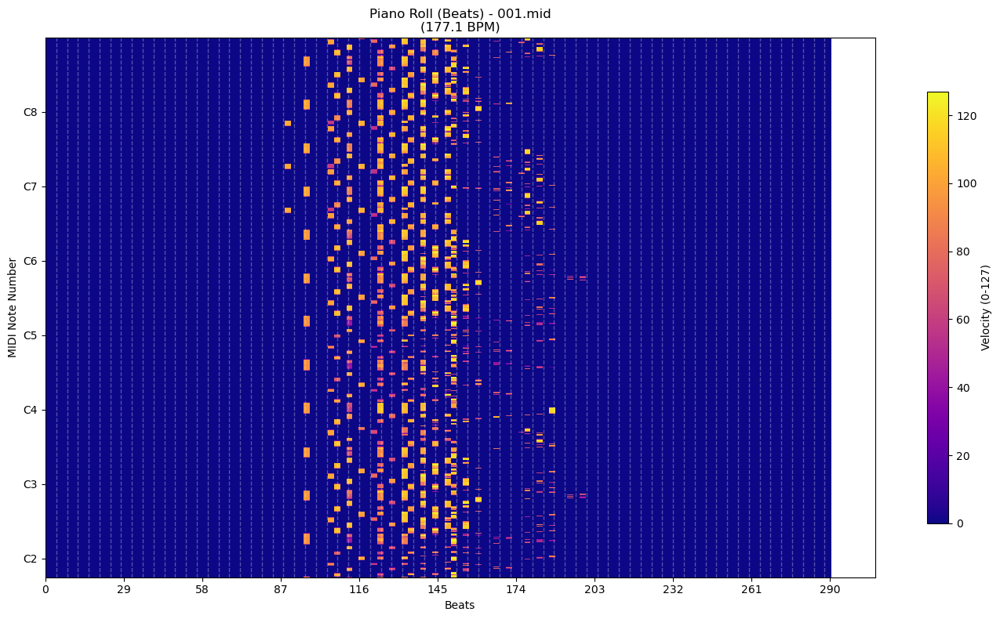

In [10]:
# Visualize the first MIDI file (beat-based)
midi_data = load_midi_file(first_midi)
if midi_data is None:
    raise RuntimeError('Failed to load the MIDI file.')

plot_piano_roll_beats(midi_data, title=f'Piano Roll (Beats) - {first_midi.name}')


Total notes: 1556
Pitch range: 39 - 87 (MIDI)
Velocity range: 29 - 127
Top 10 pitches by frequency:
  61: 185
  66: 154
  54: 143
  58: 138
  63: 108
  65: 100
  49: 99
  68: 98
  80: 72
  59: 71


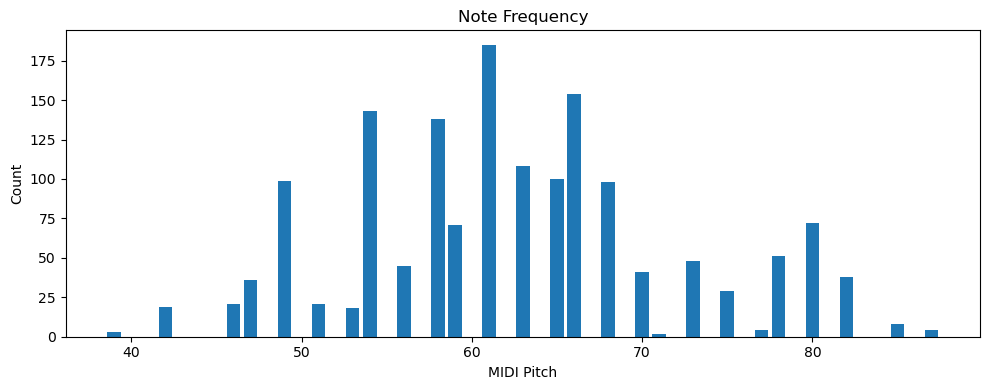

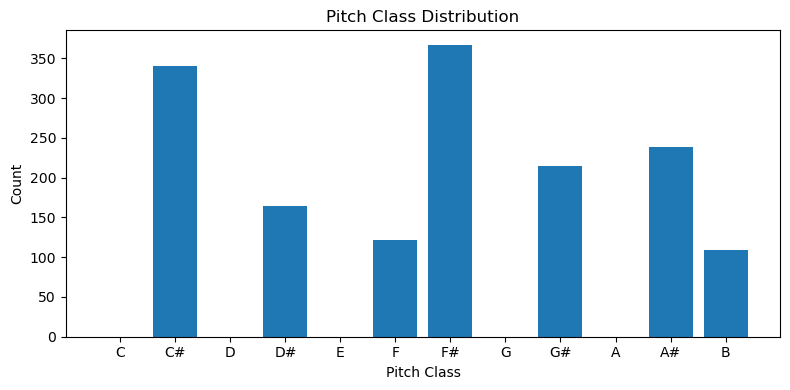

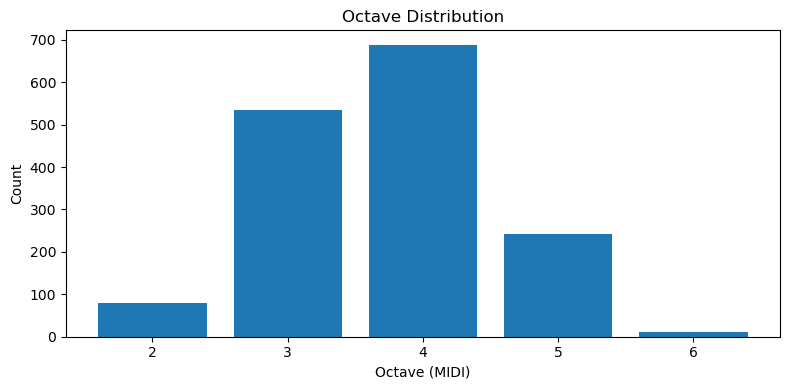

In [11]:
# Note statistics: range, frequency, velocity, and distributions
notes = []
velocities = []
for instrument in midi_data.instruments:
    for note in instrument.notes:
        notes.append(note.pitch)
        velocities.append(note.velocity)

if not notes:
    print('No notes found in the MIDI file.')
else:
    notes = np.array(notes)
    velocities = np.array(velocities)

    print(f'Total notes: {len(notes)}')
    print(f'Pitch range: {notes.min()} - {notes.max()} (MIDI)')
    print(f'Velocity range: {velocities.min()} - {velocities.max()}')

    unique, counts = np.unique(notes, return_counts=True)
    order = np.argsort(counts)[::-1]
    print('Top 10 pitches by frequency:')
    for idx in order[:10]:
        print(f'  {int(unique[idx])}: {int(counts[idx])}')

    plt.figure(figsize=(10, 4))
    plt.bar(unique, counts, width=0.8)
    plt.xlabel('MIDI Pitch')
    plt.ylabel('Count')
    plt.title('Note Frequency')
    plt.tight_layout()
    plt.show()

    pitch_classes = notes % 12
    pc_unique, pc_counts = np.unique(pitch_classes, return_counts=True)
    pc_counts_full = np.zeros(12, dtype=int)
    pc_counts_full[pc_unique] = pc_counts
    pc_names = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']

    plt.figure(figsize=(8, 4))
    plt.bar(pc_names, pc_counts_full)
    plt.xlabel('Pitch Class')
    plt.ylabel('Count')
    plt.title('Pitch Class Distribution')
    plt.tight_layout()
    plt.show()

    octaves = (notes // 12) - 1
    oct_unique, oct_counts = np.unique(octaves, return_counts=True)
    plt.figure(figsize=(8, 4))
    plt.bar(oct_unique.astype(str), oct_counts)
    plt.xlabel('Octave (MIDI)')
    plt.ylabel('Count')
    plt.title('Octave Distribution')
    plt.tight_layout()
    plt.show()


In [12]:
# Listen to the first MIDI file using the simple synth
audio = midi_to_audio(midi_data, sample_rate=44100)
max_val = np.max(np.abs(audio)) if audio.size else 0
if max_val > 0:
    audio = audio / max_val

display(Audio(audio, rate=44100))
